In [1]:
import os
import time

import jax
import jax.numpy as jnp
from jax import jit, vmap, jacrev
from jax.tree_util import tree_map

import ml_collections
from absl import logging
import wandb
import matplotlib.pyplot as plt
import seaborn as sns

from jaxpi.samplers import UniformSampler
from jaxpi.utils import save_checkpoint, restore_checkpoint, flatten_pytree, jacobian_fn

import models
from utils import get_dataset

from configs import default

from math import sqrt

In [2]:
# Import config
config = default.get_config()

In [3]:
Tmin = 0
Tmax = 2.0
Xmin = -15
Xmax = 15

n_t = Tmax * 50
n_x = Xmax * 50 * 2

x0 = 2.0
sigma = 0.2
k0 = -5

A = 1.0
hbar = 1.0
k = 1
m = 1.0

e = 0.0223607
e = 1


Tcar = max(abs(Tmin), abs(Tmax))
Xcar = max(abs(Xmin), abs(Xmax))
Mcar = m
Qcar = e
x0 /= Xcar
sigma /= Xcar
k0 *= Xcar
A *= sqrt(Xcar)


hbar = hbar / (Mcar * Xcar**2) * Tcar
m /= Mcar
e /= Qcar

k = k * Qcar**2 / (Mcar * Xcar**3) * Tcar**2

Tmin /= Tcar
Tmax /= Tcar
Xmin /= Xcar
Xmax /= Xcar
# Get  dataset
psi_real, psi_imag, t_star, x_star, Tcar, Xcar, psi_real0, psi_imag0 = get_dataset(
    Tmin,
    Tmax,
    Xmin,
    Xmax,
    n_t,
    n_x,
    x0,
    sigma,
    k0,
    A,
    hbar,
    m,
    e,
    k,
    Tcar,
    Xcar,
)

Energía inicial: 0.13376294


In [4]:
# Define domain
t0 = t_star[0]
t1 = t_star[-1]

x0 = x_star[0]
x1 = x_star[-1]
dom = jnp.array([[t0, t1],
                 [x0, x1]])

# Initialize residual sampler
res_sampler = iter(UniformSampler(dom, config.training.batch_size_per_device))

In [5]:
# Initialize model
model = models.QPINN(config, psi_real0, psi_imag0, t_star, x_star, hbar, m, e,k,Tcar, Xcar, Mcar)

In [ ]:
# Restore model paramteres
workdir = '.'
ckpt_path = os.path.join(
    "C:", "Users", "Emin", "VSCODE", "JAX-PI2", "default_", "ckpt"
)
ckpt_path = "./default_11/ckpt"
print(workdir, config.wandb.name, ckpt_path)
model.state = restore_checkpoint(model.state, ckpt_path)
params = model.state.params

. default_11 /Users/emin/JAX-PI Diodo (barrera)/default_11/ckpt


In [7]:
#real_error, imag_error = model.r_pred_fn(params, model.t_star*2, model.x_star)
#real_error = jnp.mean(jnp.square(real_error))
#imag_error = jnp.mean(jnp.square(imag_error))
#print(f"L2 error real: {real_error:.3e}, L2 error imag: {imag_error:.3e},")

In [8]:
# Compute L2 error
#real_error, imag_error = model.compute_l2_error(params, psi_real, psi_imag)
#print(f'L2 error real: {real_error:.3e}, L2 error imag: {imag_error:.3e},')

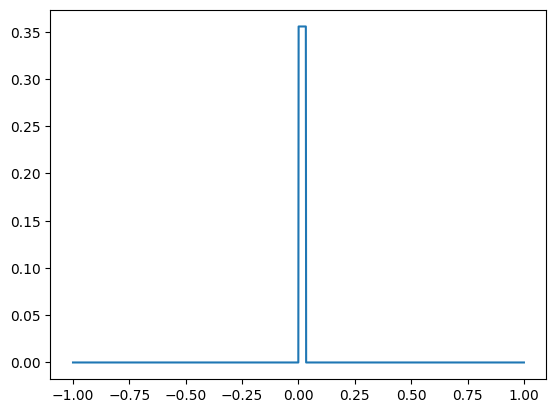

In [9]:
plt.plot(model.x_star,model.V(model.x_star))

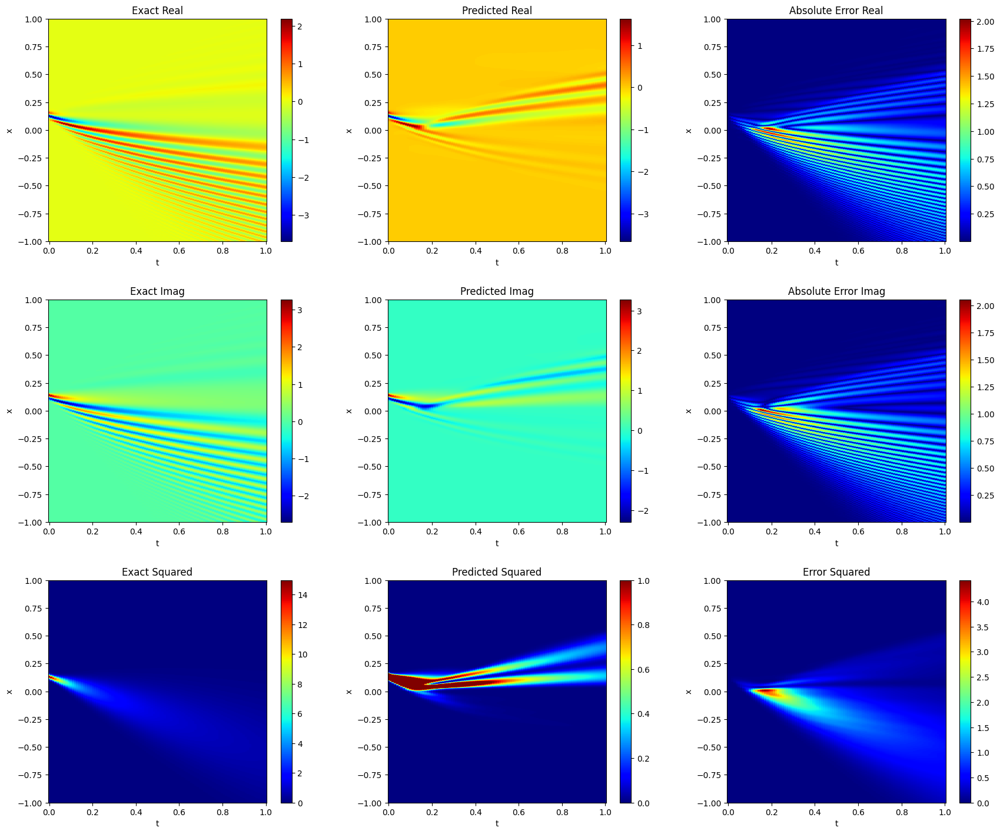

In [10]:
# Prediction
real_pred = model.real_pred_fn(params, model.t_star, model.x_star)
imag_pred = model.imag_pred_fn(params, model.t_star, model.x_star)
TT, XX = jnp.meshgrid(t_star, x_star, indexing="ij")

# Squared values
psi_squared = psi_real**2 + psi_imag**2
pred_squared = real_pred**2 + imag_pred**2

# Errors
error_real = jnp.abs(psi_real - real_pred)
error_imag = jnp.abs(psi_imag - imag_pred)
error_squared = (psi_real - real_pred) ** 2 + (psi_imag - imag_pred) ** 2

# Plot results
fig, axs = plt.subplots(3, 3, figsize=(18, 15))
fig.tight_layout(pad=5)

# Exact Real
im1 = axs[0, 0].pcolor(TT, XX, psi_real, cmap="jet")
fig.colorbar(im1, ax=axs[0, 0])
axs[0, 0].set_xlabel("t")
axs[0, 0].set_ylabel("x")
axs[0, 0].set_title("Exact Real")

# Exact Imag
im2 = axs[1, 0].pcolor(TT, XX, psi_imag, cmap="jet")
fig.colorbar(im2, ax=axs[1, 0])
axs[1, 0].set_xlabel("t")
axs[1, 0].set_ylabel("x")
axs[1, 0].set_title("Exact Imag")

# Predicted Real
im3 = axs[0, 1].pcolor(TT, XX, real_pred, cmap="jet")
fig.colorbar(im3, ax=axs[0, 1])
axs[0, 1].set_xlabel("t")
axs[0, 1].set_ylabel("x")
axs[0, 1].set_title("Predicted Real")

# Predicted Imag
im4 = axs[1, 1].pcolor(TT, XX, imag_pred, cmap="jet")
fig.colorbar(im4, ax=axs[1, 1])
axs[1, 1].set_xlabel("t")
axs[1, 1].set_ylabel("x")
axs[1, 1].set_title("Predicted Imag")

# Absolute Error Real
im5 = axs[0, 2].pcolor(TT, XX, error_real, cmap="jet")
fig.colorbar(im5, ax=axs[0, 2])
axs[0, 2].set_xlabel("t")
axs[0, 2].set_ylabel("x")
axs[0, 2].set_title("Absolute Error Real")

# Absolute Error Imag
im6 = axs[1, 2].pcolor(TT, XX, error_imag, cmap="jet")
fig.colorbar(im6, ax=axs[1, 2])
axs[1, 2].set_xlabel("t")
axs[1, 2].set_ylabel("x")
axs[1, 2].set_title("Absolute Error Imag")

# Exact Squared
im7 = axs[2, 0].pcolor(TT, XX, psi_squared, cmap="jet")
fig.colorbar(im7, ax=axs[2, 0])
axs[2, 0].set_xlabel("t")
axs[2, 0].set_ylabel("x")
axs[2, 0].set_title("Exact Squared")

# Predicted Squared
im8 = axs[2, 1].pcolor(TT, XX, pred_squared, cmap="jet", vmin=0, vmax=1)
fig.colorbar(im8, ax=axs[2, 1])
axs[2, 1].set_xlabel("t")
axs[2, 1].set_ylabel("x")
axs[2, 1].set_title("Predicted Squared")

# Error Squared
im9 = axs[2, 2].pcolor(TT, XX, error_squared, cmap="jet")
fig.colorbar(im9, ax=axs[2, 2])
axs[2, 2].set_xlabel("t")
axs[2, 2].set_ylabel("x")
axs[2, 2].set_title("Error Squared")

# Show the plot
plt.show()

# Visualize gradients

In [11]:
# Load first checkpoint 
model.state = restore_checkpoint(model.state, ckpt_path)
params = model.state.params

In [12]:
# Get a random batch
batch = next(res_sampler)
batch = jax.device_get(tree_map(lambda x: x[0], batch))

In [13]:
# Compute gradient of each loss with respect to network parameters
grads = jacrev(model.losses)(params, batch)

grad_dict = {}
for key, value in grads.items():
    flattened_grad = flatten_pytree(value)
    grad_dict[key] = flattened_grad

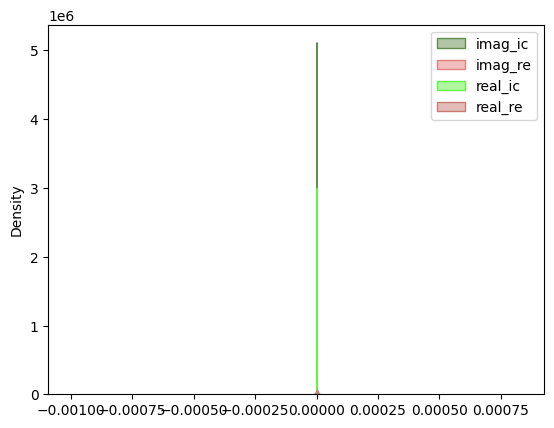

In [14]:
import random
import seaborn as sns
import matplotlib.pyplot as plt

# Función para generar un color RGB aleatorio
def random_color():
    return (random.random(), random.random(), random.random())

# Supongamos que `grad_dict` es tu diccionario
for key in grad_dict.keys():
    color = random_color()  # Generar un color aleatorio
    sns.kdeplot(grad_dict[key], fill=True, alpha=0.5, color=color, label=key)

plt.legend()
plt.show()


# Visualize NTK

In [15]:
def compute_jacobian(params, batch):
    # Calcular los jacobianos para las redes real e imaginaria.
    real_ics_jacobian = vmap(jacobian_fn, (None, None, None, 0))(model.real_net, params, model.t0, model.x_star)
    imag_ics_jacobian = vmap(jacobian_fn, (None, None, None, 0))(model.imag_net, params, model.t0, model.x_star)
    
    # Obtener la salida de r_net y separarla en dos componentes.
    #res_real , res_imag = vmap(jacobian_fn, (None, None, 0, 0))(model.r_net, params, batch[:, 0], batch[:, 1])
    
    # Crear un diccionario con los resultados.
    jacobian_dict = {
        'real_ics_jacobian': real_ics_jacobian,
        'imag_ics_jacobian': imag_ics_jacobian,
    }
    
    return jacobian_dict


def compute_full_ntk(params, batch):
    jacobian_dict = compute_jacobian(params, batch)
    
    ntk_dict = {}
    for key, values in jacobian_dict.items():
        ntk_dict[key] = values @ values.T

    return ntk_dict


In [16]:
# Compute full NTK matrix
ntk_dict = compute_full_ntk(params, batch)

# Compute eigenvalue of each NTK
eigval_dict = {}
for key, values in ntk_dict.items():
    eigval, eigvec = jnp.linalg.eigh (values)
    eigval_dict[key] = eigval

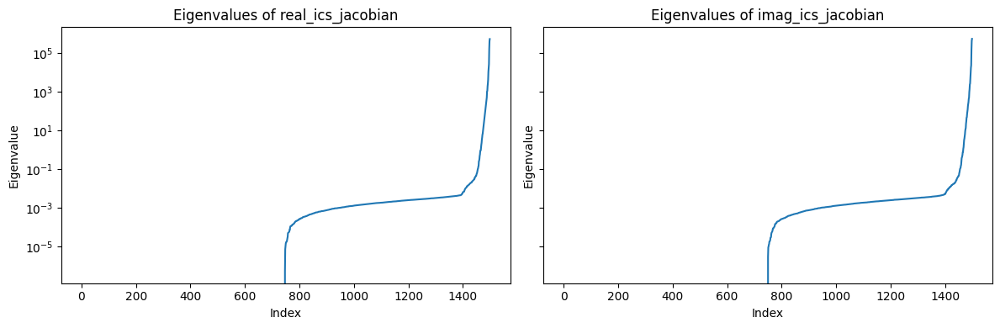

In [17]:
import matplotlib.pyplot as plt

# Crear subplots en una fila, con tantos gráficos como claves en el diccionario
fig, axes = plt.subplots(1, len(eigval_dict.keys()), figsize=(6 * len(eigval_dict), 4), sharey=True)

# Si solo hay una clave, aseguramos que `axes` sea iterable
if len(eigval_dict.keys()) == 1:
    axes = [axes]

# Graficar cada conjunto de valores propios en su subplot correspondiente
for ax, key in zip(axes, eigval_dict.keys()):
    ax.plot(eigval_dict[key])
    ax.set_title(f'Eigenvalues of {key}')
    ax.set_xlabel('Index')
    ax.set_ylabel('Eigenvalue')
    ax.set_yscale('log')

plt.tight_layout()
plt.show()


# Visualize temporal residuals

In [18]:
@jit 
def compute_temporal_residuals(params, batch):
    # Sort temporal coordinates for computing  temporal weights
    t_sorted = batch[:, 0].sort()
    # Compute residuals over the full domain
    real_pred, imag_pred, = vmap(model.r_net, (None, 0, 0))(params, t_sorted, batch[:, 1])

    print(f"Real residuals: {real_pred.shape}")
    # Split residuals into chunks
    real_pred = real_pred.reshape(config.weighting.num_chunks, -1)
    imag_pred = imag_pred.reshape(config.weighting.num_chunks, -1)
    res_real = jnp.mean(real_pred ** 2, axis=1)
    res_imag = jnp.mean(imag_pred ** 2, axis=1)
    return res_real, res_imag

In [19]:
t = jnp.linspace(t0, t1, config.weighting.num_chunks)

temporal_residuals_real,temporal_residuals_imag= compute_temporal_residuals(params, batch)

Real residuals: (16,)


Text(0, 0.5, '$L_r$')

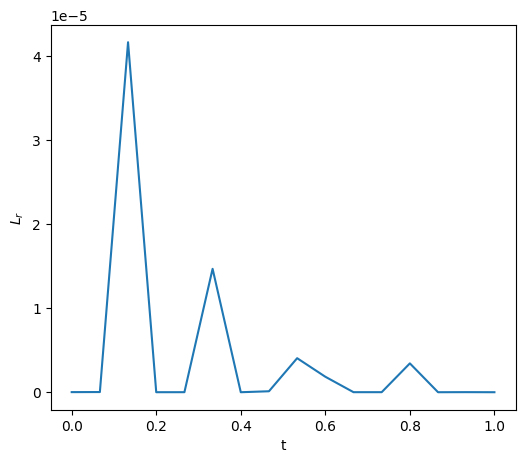

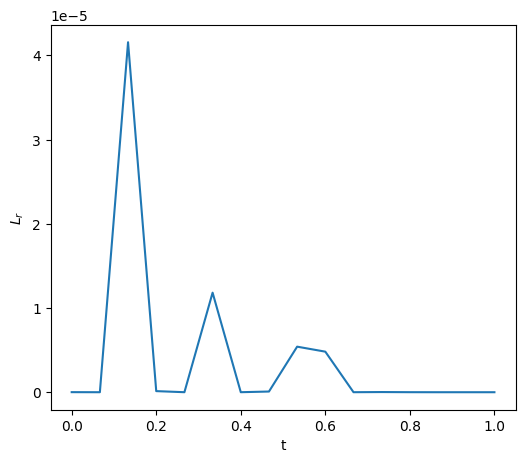

In [20]:
plt.figure(figsize=(6, 5))

plt.plot(t, temporal_residuals_real)

plt.xlabel('t')
plt.ylabel('$L_r$')

plt.figure(figsize=(6, 5))

plt.plot(t, temporal_residuals_imag)

plt.xlabel('t')
plt.ylabel('$L_r$')

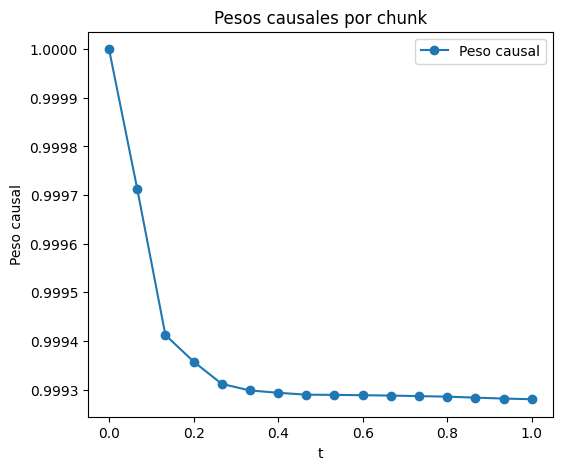

In [21]:
_, _, causal_weights = model.res_and_w(params, batch)

# Generar el vector de tiempos correspondiente a cada chunk
t = jnp.linspace(t0, t1, config.weighting.num_chunks)

# Graficar los pesos causales por chunk
plt.figure(figsize=(6, 5))
plt.plot(t, causal_weights, "-o", label="Peso causal")
plt.xlabel("t")
plt.ylabel("Peso causal")
plt.title("Pesos causales por chunk")
plt.legend()
plt.show()

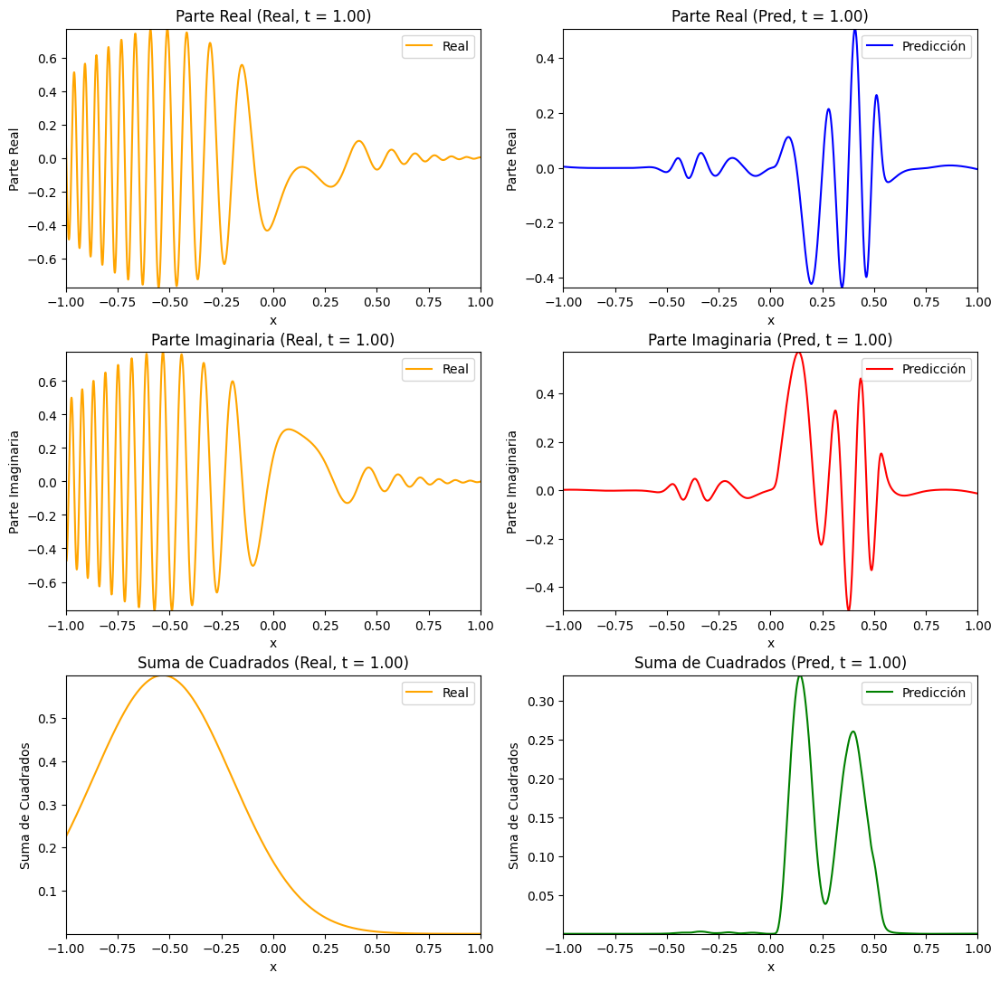

In [22]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import jax.numpy as jnp
import numpy as np
import matplotlib as mpl

mpl.rcParams["animation.embed_limit"] = 500

# Convertir arrays de JAX a NumPy si es necesario
real_pred = np.array(real_pred)
imag_pred = np.array(imag_pred)
psi_real = np.array(psi_real)
psi_imag = np.array(psi_imag)
t_star = np.array(t_star)
x_star = np.array(x_star)

# Calcular la suma de cuadrados
sum_of_squares_pred = real_pred**2 + imag_pred**2
sum_of_squares_real = psi_real**2 + psi_imag**2

# Configurar la figura y los ejes
fig = plt.figure(figsize=(13, 13))

# Crear subplots para los gráficos reales (izquierda)
ax_real_left = plt.subplot2grid((3, 2), (0, 0))
ax_imag_left = plt.subplot2grid((3, 2), (1, 0))
ax_sum_left = plt.subplot2grid((3, 2), (2, 0))

# Crear subplots para los gráficos predichos (derecha)
ax_real = plt.subplot2grid((3, 2), (0, 1))
ax_imag = plt.subplot2grid((3, 2), (1, 1))
ax_sum = plt.subplot2grid((3, 2), (2, 1))

# Ajustar espacio entre los subplots
plt.subplots_adjust(hspace=0.25, wspace=0.2)

# Configurar límites para los gráficos reales y predichos
for ax, data, title, ylabel in zip(
    [ax_real_left, ax_imag_left, ax_sum_left, ax_real, ax_imag, ax_sum],
    [
        psi_real,
        psi_imag,
        sum_of_squares_real,
        real_pred,
        imag_pred,
        sum_of_squares_pred,
    ],
    [
        "Parte Real (Real)",
        "Parte Imaginaria (Real)",
        "Suma de Cuadrados (Real)",
        "Parte Real (Pred)",
        "Parte Imaginaria (Pred)",
        "Suma de Cuadrados (Pred)",
    ],
    ["Parte Real", "Parte Imaginaria", "Suma de Cuadrados"] * 2,
):
    ax.set_xlim(x_star.min(), x_star.max())
    ax.set_ylim(data.min(), data.max())
    ax.set_xlabel("x")
    ax.set_ylabel(ylabel)
    ax.set_title(title)

# Inicializar las líneas para predicciones y datos reales
(line_real_left,) = ax_real_left.plot([], [], color="orange", label="Real")
(line_imag_left,) = ax_imag_left.plot([], [], color="orange", label="Real")
(line_sum_left,) = ax_sum_left.plot([], [], color="orange", label="Real")

(line_real,) = ax_real.plot([], [], color="blue", label="Predicción")
(line_imag,) = ax_imag.plot([], [], color="red", label="Predicción")
(line_sum,) = ax_sum.plot([], [], color="green", label="Predicción")


# Añadir leyendas
for ax in [ax_real_left, ax_imag_left, ax_sum_left, ax_real, ax_imag, ax_sum]:
    ax.legend()


def init():
    """Inicializa las líneas para la animación."""
    line_real_left.set_data([], [])
    line_imag_left.set_data([], [])
    line_sum_left.set_data([], [])
    line_real.set_data([], [])
    line_imag.set_data([], [])
    line_sum.set_data([], [])
    return line_real_left, line_imag_left, line_sum_left, line_real, line_imag, line_sum


def animate(i):
    """Actualiza las líneas para cada cuadro de la animación y ajusta los límites del eje y dinámicamente."""
    # Extraer los datos del frame actual
    frame_psi_real = psi_real[i, :]
    frame_psi_imag = psi_imag[i, :]
    frame_sum_real = sum_of_squares_real[i, :]

    frame_real_pred = real_pred[i, :]
    frame_imag_pred = imag_pred[i, :]
    frame_sum_pred = sum_of_squares_pred[i, :]

    # Actualizar las líneas de los datos reales (izquierda)
    line_real_left.set_data(x_star, frame_psi_real)
    line_imag_left.set_data(x_star, frame_psi_imag)
    line_sum_left.set_data(x_star, frame_sum_real)

    # Actualizar las líneas de las predicciones (derecha)
    line_real.set_data(x_star, frame_real_pred)
    line_imag.set_data(x_star, frame_imag_pred)
    line_sum.set_data(x_star, frame_sum_pred)

    # Actualizar límites del eje y para cada subplot
    ax_real_left.set_ylim(frame_psi_real.min(), frame_psi_real.max())
    ax_imag_left.set_ylim(frame_psi_imag.min(), frame_psi_imag.max())
    ax_sum_left.set_ylim(frame_sum_real.min(), frame_sum_real.max())

    ax_real.set_ylim(frame_real_pred.min(), frame_real_pred.max())
    ax_imag.set_ylim(frame_imag_pred.min(), frame_imag_pred.max())
    ax_sum.set_ylim(frame_sum_pred.min(), frame_sum_pred.max())

    # Actualizar los títulos con el tiempo actual
    tiempo_actual = t_star[i]
    for ax, title in zip(
        [ax_real_left, ax_imag_left, ax_sum_left, ax_real, ax_imag, ax_sum],
        [
            f"Parte Real (Real, t = {tiempo_actual:.2f})",
            f"Parte Imaginaria (Real, t = {tiempo_actual:.2f})",
            f"Suma de Cuadrados (Real, t = {tiempo_actual:.2f})",
            f"Parte Real (Pred, t = {tiempo_actual:.2f})",
            f"Parte Imaginaria (Pred, t = {tiempo_actual:.2f})",
            f"Suma de Cuadrados (Pred, t = {tiempo_actual:.2f})",
        ],
    ):
        ax.set_title(title)

    return line_real_left, line_imag_left, line_sum_left, line_real, line_imag, line_sum


# Número de cuadros en la animación
fps = 25
n_frames = len(t_star)


interval = Tmax / n_frames
# Crear la animación
anim = animation.FuncAnimation(
    fig, animate, init_func=init, frames=n_frames, interval=interval, blit=True
)

# Mostrar la animación en el notebook
HTML(anim.to_jshtml())